Variables in file: dict_keys(['crs', 'lat', 'lon', 'time', 'time_str', 'SWE', 'DEPTH'])


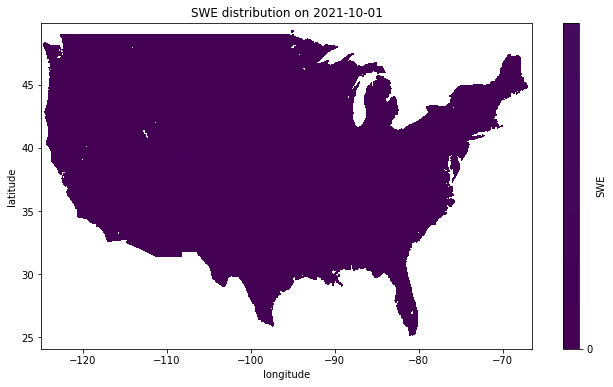

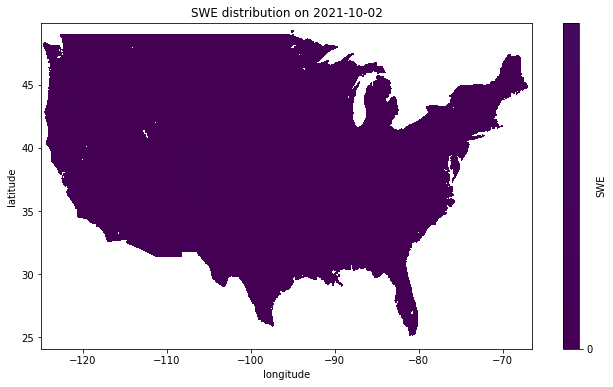

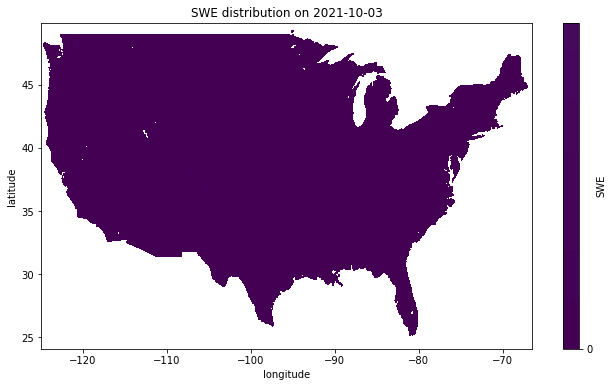

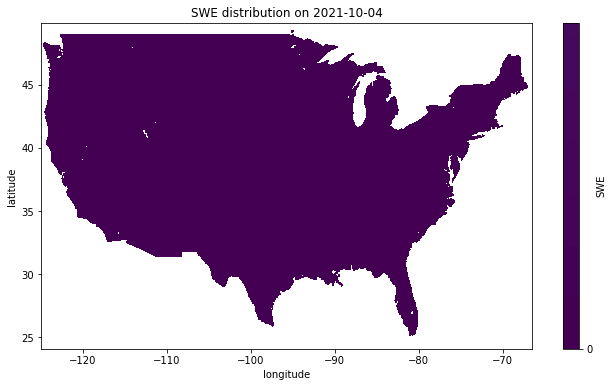

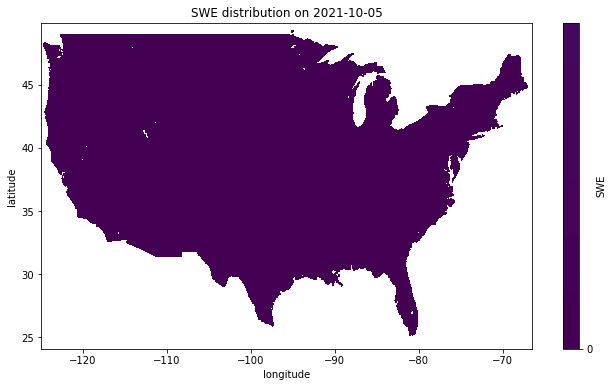

...

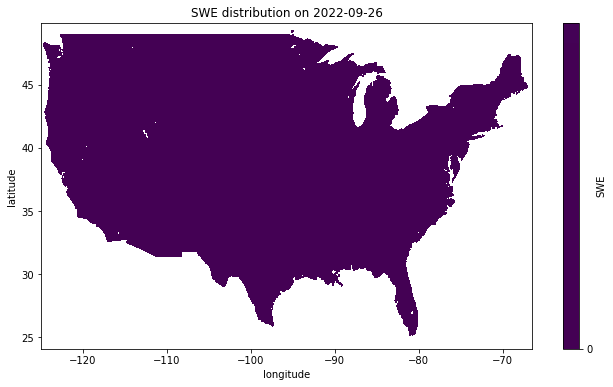

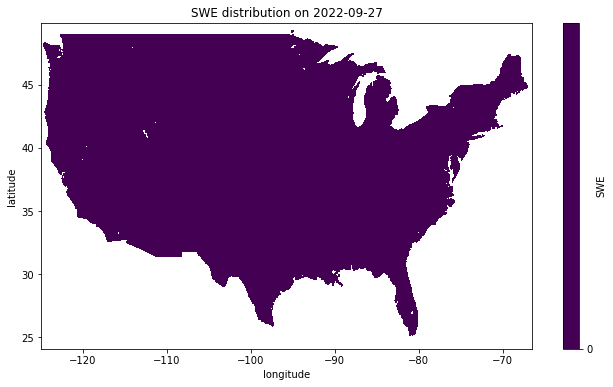

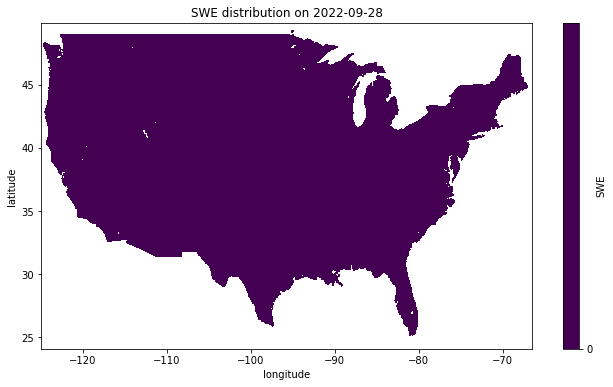

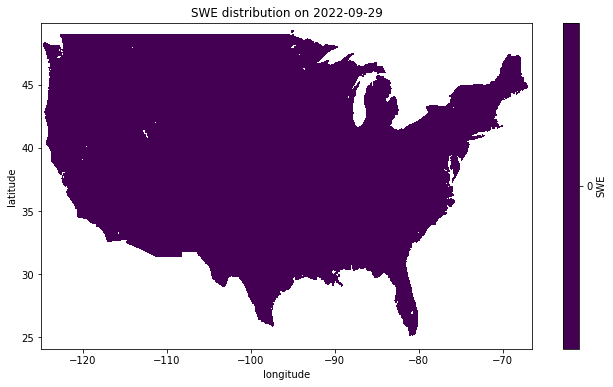

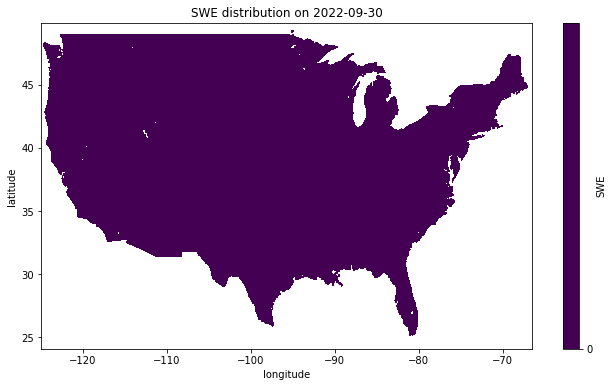

In [47]:
import matplotlib.pyplot as plt
import pandas as pd
import netCDF4 as nc
import numpy as np
import datetime

fp = 'C:/Users/Ethan/OneDrive/Documents/CSM/MS Thesis/4km_SWE_Depth_WY2022_v01.nc'
dataset = nc.Dataset(fp)

print("Variables in file:", dataset.variables.keys())

crs = dataset.variables['crs'][:]
lat = dataset.variables['lat'][:]
lon = dataset.variables['lon'][:]
time = dataset.variables['time'][:]
SWE = dataset.variables['SWE'][:]
Depth = dataset.variables['DEPTH'][:]

dataset.close()


# Define the reference date (change this based on the dataset or software's reference date)
reference_date = datetime.datetime(1900, 1, 1)  # For example, the reference date is January 1, 1900

human_readable_dates = [
    (reference_date + datetime.timedelta(days=int(time_val))).strftime("%Y-%m-%d")
    for time_val in time
]                        

SWE = np.ma.masked_where(np.isnan(SWE),SWE)

global_min = np.nanmin(SWE)
global_max = np.nanmax(SWE)


for time_index, date in enumerate(human_readable_dates):
    SWE_slice=SWE[time_index, :,:]
#colorbar_levels=np.linspace(0,1500,12)
    plt.figure(figsize=(11,6))
    plt.contourf(lon, lat, SWE_slice, levels=50, vmin = global_min, vmax=global_max)
    plt.colorbar(label='SWE', ticks=np.linspace(global_min, global_max, 11))
    plt.xlabel('longitude')
    plt.ylabel('latitude')
    plt.title(f'SWE distribution on {date}')
    plt.show()



In [31]:
time


masked_array(data=[44468., 44469., 44470., 44471., 44472., 44473., 44474.,
                   44475., 44476., 44477., 44478., 44479., 44480., 44481.,
                   44482., 44483., 44484., 44485., 44486., 44487., 44488.,
                   44489., 44490., 44491., 44492., 44493., 44494., 44495.,
                   44496., 44497., 44498., 44499., 44500., 44501., 44502.,
                   44503., 44504., 44505., 44506., 44507., 44508., 44509.,
                   44510., 44511., 44512., 44513., 44514., 44515., 44516.,
                   44517., 44518., 44519., 44520., 44521., 44522., 44523.,
                   44524., 44525., 44526., 44527., 44528., 44529., 44530.,
                   44531., 44532., 44533., 44534., 44535., 44536., 44537.,
                   44538., 44539., 44540., 44541., 44542., 44543., 44544.,
                   44545., 44546., 44547., 44548., 44549., 44550., 44551.,
                   44552., 44553., 44554., 44555., 44556., 44557., 44558.,
                   44559.

In [35]:
import datetime

# Define the reference date (change this based on the dataset or software's reference date)
reference_date = datetime.datetime(1900, 1, 1)  # For example, the reference date is January 1, 1900

human_readable_dates = []
for numeric_date in time:
    calculated_date = reference_date + datetime.timedelta(days=int(numeric_date))
    human_readable_dates.append(calculated_date)

# Print the human-readable dates
for idx, date in enumerate(human_readable_dates):
    print(f"Time Value {idx + 1}: Numeric Date - {time[idx]}, Human-Readable Date - {date}")


Time Value 1: Numeric Date - 44468.0, Human-Readable Date - 2021-10-01 00:00:00
Time Value 2: Numeric Date - 44469.0, Human-Readable Date - 2021-10-02 00:00:00
Time Value 3: Numeric Date - 44470.0, Human-Readable Date - 2021-10-03 00:00:00
Time Value 4: Numeric Date - 44471.0, Human-Readable Date - 2021-10-04 00:00:00
Time Value 5: Numeric Date - 44472.0, Human-Readable Date - 2021-10-05 00:00:00
Time Value 6: Numeric Date - 44473.0, Human-Readable Date - 2021-10-06 00:00:00
Time Value 7: Numeric Date - 44474.0, Human-Readable Date - 2021-10-07 00:00:00
Time Value 8: Numeric Date - 44475.0, Human-Readable Date - 2021-10-08 00:00:00
Time Value 9: Numeric Date - 44476.0, Human-Readable Date - 2021-10-09 00:00:00
Time Value 10: Numeric Date - 44477.0, Human-Readable Date - 2021-10-10 00:00:00
Time Value 11: Numeric Date - 44478.0, Human-Readable Date - 2021-10-11 00:00:00
Time Value 12: Numeric Date - 44479.0, Human-Readable Date - 2021-10-12 00:00:00
Time Value 13: Numeric Date - 44480.0

Variables in file: dict_keys(['crs', 'lat', 'lon', 'time', 'time_str', 'SWE', 'DEPTH'])


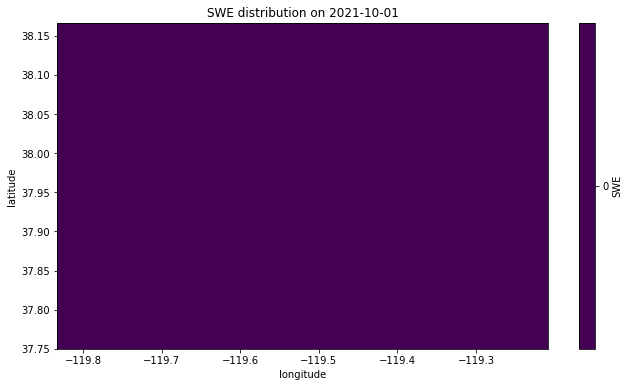

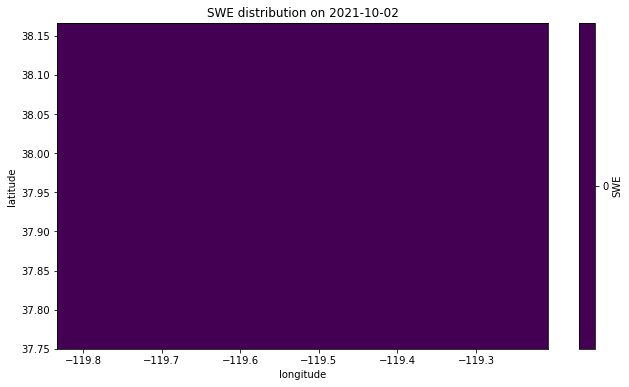

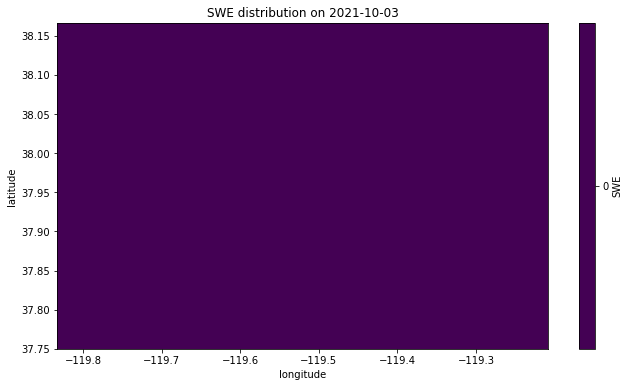

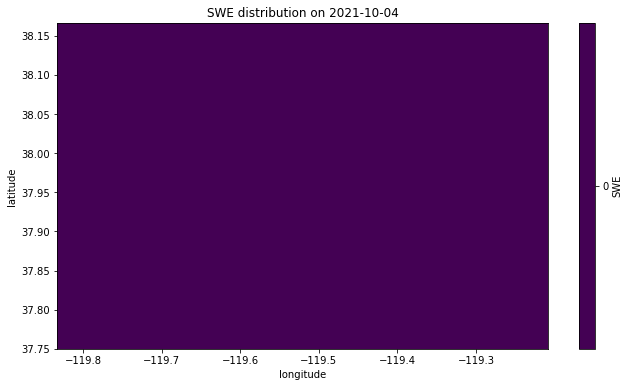

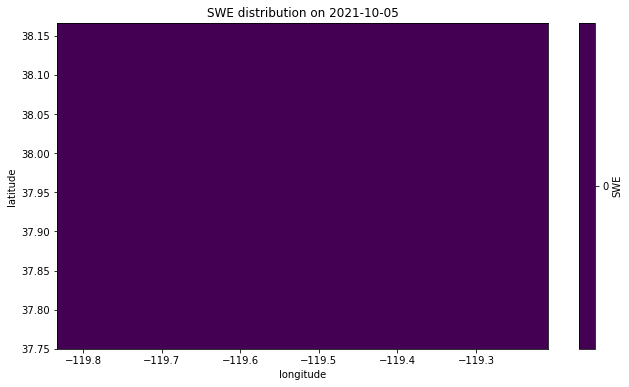

...

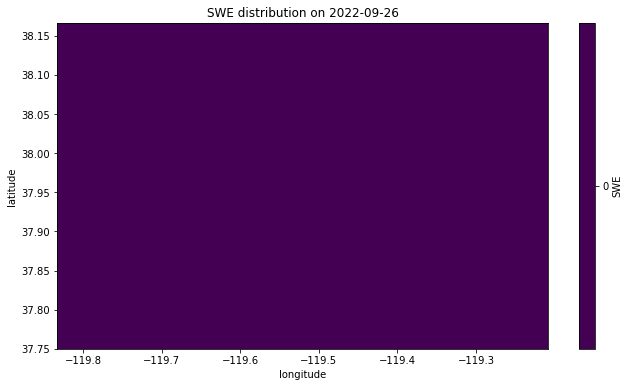

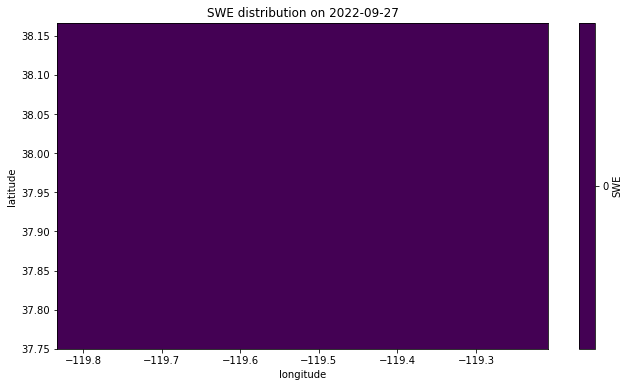

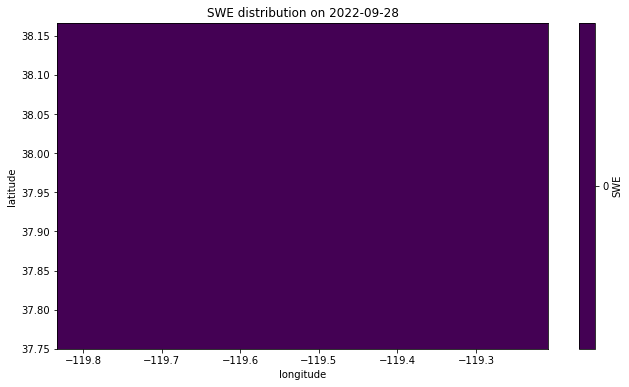

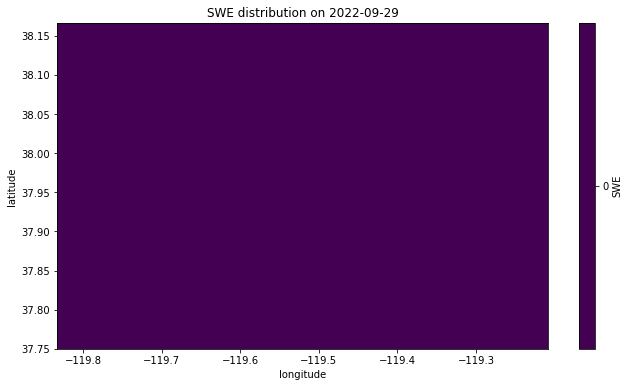

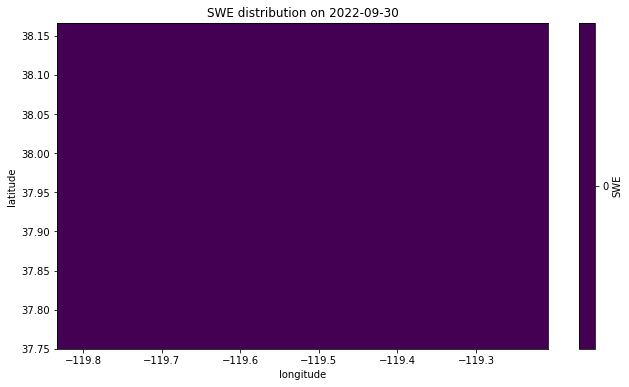

In [48]:
#Import potentially necessary libraries.
import matplotlib.pyplot as plt
import pandas as pd
import netCDF4 as nc
import numpy as np
import datetime

#Establish file path and name the dataset to make it more easily accessed. 
fp = 'C:/Users/Ethan/OneDrive/Documents/CSM/MS Thesis/4km_SWE_Depth_WY2022_v01.nc'
dataset = nc.Dataset(fp)

#Print variables in the dataset so I can call them later.
print("Variables in file:", dataset.variables.keys())

#Naming the variables
crs = dataset.variables['crs'][:]
lat = dataset.variables['lat'][:]
lon = dataset.variables['lon'][:]
time = dataset.variables['time'][:]
SWE = dataset.variables['SWE'][:]
Depth = dataset.variables['DEPTH'][:]
dataset.close()

#Set lat, lon boundaries
lat_min, lat_max = 37.75, 38.2
lon_min, lon_max = -119.85, -119.20

#Establishing lat, lon boundaries within the dataset so as only to use indices within AOI
lat_indices = np.where((lat >= lat_min) & (lat <= lat_max))[0]
lon_indices = np.where((lon >= lon_min) & (lon <= lon_max))[0]

##For the time variable, it is stored as a numeric value that is the number of days since a reference date (i.e. time of
## 45000 represents 44500 days since the reference date). I would like to convert it to a date format.
# Define the reference date
reference_date = datetime.datetime(1900, 1, 1)  #the reference date is January 1, 1900
#Add the reference date and number of days passed at each time index to create a date format for each time index
human_readable_dates = [
    (reference_date + datetime.timedelta(days=int(time_val))).strftime("%Y-%m-%d")
    for time_val in time
]                        

#Establish the SWE AOI to be within the previously defined lat, lon boundary
SWE_area = SWE[:, lat_indices[0]: lat_indices[-1]+1, lon_indices[0]: lon_indices[-1]+1]
SWE_area=np.ma.masked_where(np.isnan(SWE_area), SWE_area) #mask NaN values so NaN values are not included in plotting

#Define the local min and max of the boundary to establish a fixed colorbar over the water year.
local_min = np.nanmin(SWE_area)
local_max = np.nanmax(SWE_area)

#Loop through each day in the dataset and pull out the SWE values for that date 
for time_index, date in enumerate(human_readable_dates):
    SWE_slice=SWE_area[time_index, :,:] #get SWE at specific time index

    plt.figure(figsize=(11,6)) #set figure size
    plt.contourf(lon[lon_indices], lat[lat_indices], SWE_slice, levels=50, vmin = local_min, vmax=local_max)
    plt.colorbar(label='SWE', ticks=np.linspace(local_min, local_max, 11))
    plt.xlabel('longitude')
    plt.ylabel('latitude')
    plt.title(f'SWE distribution on {date}')
    plt.show()



Variables in file: dict_keys(['crs', 'lat', 'lon', 'time', 'time_str', 'SWE', 'DEPTH'])


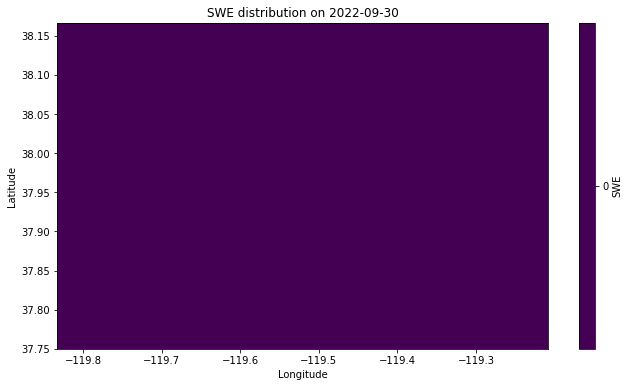

In [49]:
import matplotlib.pyplot as plt
import pandas as pd
import netCDF4 as nc
import numpy as np
import datetime
from matplotlib.animation import FuncAnimation

# Establish file path and name the dataset to make it more easily accessed.
fp = 'C:/Users/Ethan/OneDrive/Documents/CSM/MS Thesis/4km_SWE_Depth_WY2022_v01.nc'
dataset = nc.Dataset(fp)

# Print variables in the dataset so I can call them later.
print("Variables in file:", dataset.variables.keys())

# Naming the variables
crs = dataset.variables['crs'][:]
lat = dataset.variables['lat'][:]
lon = dataset.variables['lon'][:]
time = dataset.variables['time'][:]
SWE = dataset.variables['SWE'][:]
Depth = dataset.variables['DEPTH'][:]
dataset.close()

# Set lat, lon boundaries
lat_min, lat_max = 37.75, 38.2
lon_min, lon_max = -119.85, -119.20

# Establishing lat, lon boundaries within the dataset so as only to use indices within AOI
lat_indices = np.where((lat >= lat_min) & (lat <= lat_max))[0]
lon_indices = np.where((lon >= lon_min) & (lon <= lon_max))[0]

# For the time variable, it is stored as a numeric value that is the number of days since a reference date
# (i.e. time of 45000 represents 44500 days since the reference date).
# I would like to convert it to a date format.
# Define the reference date
reference_date = datetime.datetime(1900, 1, 1)  # the reference date is January 1, 1900

# Add the reference date and number of days passed at each time index to create a date format for each time index
human_readable_dates = [
    (reference_date + datetime.timedelta(days=int(time_val))).strftime("%Y-%m-%d")
    for time_val in time
]

# Establish the SWE AOI to be within the previously defined lat, lon boundary
SWE_area = SWE[:, lat_indices[0]: lat_indices[-1] + 1, lon_indices[0]: lon_indices[-1] + 1]
SWE_area = np.ma.masked_where(np.isnan(SWE_area), SWE_area)  # mask NaN values

# Define the local min and max of the boundary to establish a fixed colorbar over the water year.
local_min = np.nanmin(SWE_area)
local_max = np.nanmax(SWE_area)

# Create a figure
fig, ax = plt.subplots(figsize=(11, 6))

# Create an animation function
def update(frame):
    plt.clf()
    
    # Calculate the date for the current frame
    current_date = reference_date + datetime.timedelta(days=int(time[frame]))
    SWE_slice = SWE_area[frame, :, :]

    # Plot the SWE data
    plot = plt.contourf(lon[lon_indices], lat[lat_indices], SWE_slice, levels=50, vmin=local_min, vmax=local_max)
    plt.colorbar(plot, label='SWE', ticks=np.linspace(local_min, local_max, 11))
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.title(f'SWE distribution on {current_date.strftime("%Y-%m-%d")}')

# Create the animation
animation = FuncAnimation(fig, update, frames=len(time), interval=1000 / 5)

# Save the animation as an MP4 file
animation_file_path = 'swe_animation.mp4'
animation.save(animation_file_path, writer='ffmpeg', fps=5, dpi=300)

# Display the animation
plt.show()


In [1]:
##Attempt to pull data directly from the site
#import libraries
import requests 
from bs4 import BeautifulSoup
import os

url = "https://daacdata.apps.nsidc.org/pub/DATASETS/nsidc0719_SWE_Snow_Depth_v1/"
save_path = "C:/Users/Ethan/OneDrive/Documents/CSM/MS Thesis/datasets/SWANN_data"

response = requests.get(url)

soup = BeautifulSoup(response.text, 'html.parser')

links = soup.find_all('a', href=True)

for link in links:
    file_url = url+link['href']
    file_name = os.path.join(save_path, link['href'])
    response = requests.get(file_url)
    
    with open(file_name, 'wb') as file:
        file.write(response.content)
        
print("files downloaded successfully.")

##Attempt failed, using wget instead, moving on to Draft 2 with full datasset 1/19/2023

PermissionError: [Errno 13] Permission denied: 'C:/'